# Question: Based on NPRI data, which industry is predicted to have the highest growth of releases in 2023? Which will have the largest decline?

Moyosore Akinola - makinola@norquest.ca

Gift Ajayi - gajayi@norquest.ca

Oluwaseun Ademokun - oademokun@norquest.ca

Chioma Ulom - culom@norquest.ca

UNDERSTANDING THE DATA

What is the NPRI?

NPRI (National Pollutant Release Inventory) is Canada's primary source of information on pollutants released to the environment, disposed of, or transferred for recycling. Managed by Environment and Climate Change Canada (ECCC), the NPRI tracks a wide range of substances that are considered harmful to human health or the environment. Industries that meet certain thresholds are required to report their releases, disposals, and transfers of pollutants annually.

The NPRI serves multiple purposes:
Environmental Protection: Helps monitor pollution and supports the development of policies to reduce environmental harm. Public Right-to-Know: Provides transparency on what pollutants are being emitted and by whom, enabling citizens and stakeholders to hold industries accountable. Tracking Progress: Allows the government to track trends in pollution and assess the effectiveness of environmental regulations and programs. Research and Decision-Making: Used by researchers, non-governmental organizations, and policymakers to inform decisions on environmental health.

DATA RELEVANCE
This dataset includes data reported to the NPRI by various industries over two decades (2000–2020). It provides details about pollutants released into air, water, and land, as well as waste disposal and transfers for recycling. This data is critical for understanding:

Industry-Specific Environmental Impact: By analyzing the releases and disposals, one can identify which industries (e.g., chemical manufacturing, mining, pulp mills) are responsible for the highest pollutant emissions and track their trends over time.

Geographic Distribution of Pollution: The data includes information on the locations of the facilities (e.g., city, province), which helps map pollution hotspots across Canada and see which regions are most affected.

Compliance and Regulatory Insight: The NPRI data helps track whether companies are complying with environmental regulations or if additional enforcement is needed to mitigate pollution in particular areas or industries.

Progress Toward Sustainability Goals: NPRI data allows organizations, including NGOs or government agencies, to evaluate if pollution is being reduced and whether sustainability goals are being met.

INSIGHTS FROM THE DATA
RUNDERSTANDING OF DATASET
1. RELEASES
Dataset contains releases of substances from year 2000 - 2022 from majorly from majorly 5 industries: Conventional oil and gas extraction, oil and gas extraction (except oil sands), fossil fuel electric power generation, chemical pulp mills and petroleum refineries
Substances comprise mostly of Particulate matter <= 2.5 Micrometers, Particulate matter <=10 Micrometers, Nitrogen oxides, Carbon monoxide, Volatile organic compounds.
Contains 737516 rows and 28 columns
Releases are from different provinces in Canada.
The units of these releases vary with tonnes, kg,g TEQ, grams

2. DISPOSALS AND TRANSFERS
Dataset contains releases of substances from year 2000 - 2022 from majorly from majorly 5 industries: Sewage treatment facilities, Conventional oil and gas extraction, Petroleum refineries, Waste disposal treatment and disposal, Chemical pulp mills.
Substances comprise mostly of Lead, Zinc, Manganese, Copper, Xylene
Contains 191645 rows and 41 columns.
Disposal are from different provinces in Canada.
The units of these disposals vary with tonnes, kg,g TEQ, grams

3. COMMENTS
Data contain information of data collected for releases, disposals and transfers between year 2000- 2022 pertaining majorly to these industries: Conventional Oil and Gas Extraction, Oil and gas extraction (except oil sands), Sewage treatment facilities, Conventional oil and gas extraction and Waste treatment and disposal
Comments are mostly about the Substances: Particulate Matter <= 2.5 Micrometers, Particulate Matter <= 10 Micrometers, Nitrogen oxides (expressed as nitrogen dioxide), Carbon monoxide and Lead (and its compounds)
Contains 363310 rows and 14 columns.

In summary, the NPRI data is crucial for environmental accountability, helping various stakeholders—from government agencies to advocacy groups—understand and act upon pollution data for improved environmental management across Canada.

##Issue Detection

**Missing Values:**

Several fields contain blanks especially in the 'releases' columns where the are over 95% missing values in some columns. This could hinder data analysis and interpretation.

**Inconsistent Units:** The units for substances are not standardized (e.g., some are in tonnes, others in kg). Consistency is essential for accurate aggregation and comparison.


**Invalid or Incomplete CAS Numbers:** Some CAS numbers are marked as "NA - xx," which indicates that they might be invalid or improperly formatted, potentially affecting data integrity.

**Sum of Releases to All Media:** The column "Sum of release to all media (<1tonne)" has several blanks. This could indicate that data was not aggregated or reported properly.

**Geographic Coordinates:** While latitude and longitude values are provided, there’s no indication of their accuracy or whether they have been verified. Inaccurate geographic data can lead to misinterpretation in spatial analysis.

**Estimation Method Clarity:**

The terms used for estimation methods (e.g., "M - Monitoring or Direct Measurement", "E - Emission Factor") need clearer definitions for consistency in understanding how releases are reported.

**Inconsistent Naming:** Some substance names are formatted differently (e.g., "Methanol" vs. "Methanol (and its salts)"), which could lead to difficulties in aggregating or comparing substances.

**Formatting Issues:** There may be formatting inconsistencies, such as varying decimal places in the release quantities, which could complicate data analysis.

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer
import statsmodels.api as sm



In [ ]:
# Load the dataset, specifying the encoding as 'latin-1'
df = pd.read_csv('NPRI_Releases.csv', encoding='latin-1')

#Setting up notebook so that all columns are displayed
pd.set_option('display.max_columns', None)

# Preview the dataset

df.head()

<ipython-input-17-35a4951ff3c3>:2: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('NPRI_Releases.csv', encoding='latin-1')


,Reporting_Year / Année,NPRI_ID / No_INRP,Number of employees,Company_Name / Dénomination_sociale_de_l'entreprise,Facility_Name / Installation,NAICS / Code_SCIAN,NAICS Title / Titre Code_SCIAN,PROVINCE,City,Latitude,Longitude,CAS_Number / No_CAS,Substance Name (English) / Nom de substance (Anglais),Units / Unités,Estimation_Method / Méthode_destimation,Release to Air - Fugitive,Release to Air - Other Non-Point,Release to Air - Road dust,Release to Air - Spills,Release to Air - Stack / Point,Release to Air - Storage / Handling,Releases to Land - Leaks,Releases to Land - Other,Releases to Land - Spills,Releases to Water Bodies - Direct Discharges,Releases to Water Bodies - Leaks,Releases to Water Bodies - Spills,Sum of release to all media (<1tonne)
0,2000,1,440,Alberta-Pacific Forest Industries Inc.,(blank),322112,Chemical pulp mills,AB,County of Athabasca,54.923116,-112.861867,10049-04-4,Chlorine dioxide,tonnes,M - Monitoring or Direct Measurement,NaN,NaN,NaN,NaN,5.200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2000,1,440,Alberta-Pacific Forest Industries Inc.,(blank),322112,Chemical pulp mills,AB,County of Athabasca,54.923116,-112.861867,67-56-1,Methanol,tonnes,E - Emission Factor,NaN,NaN,NaN,NaN,113.000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2000,1,440,Alberta-Pacific Forest Industries Inc.,(blank),322112,Chemical pulp mills,AB,County of Athabasca,54.923116,-112.861867,67-66-3,Chloroform,tonnes,M - Monitoring or Direct Measurement,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN
3,2000,1,440,Alberta-Pacific Forest Industries Inc.,(blank),322112,Chemical pulp mills,AB,County of Athabasca,54.923116,-112.861867,75-07-0,Acetaldehyde,tonnes,E - Emission Factor,NaN,NaN,NaN,NaN,7.670,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2000,1,440,Alberta-Pacific Forest Industries Inc.,(blank),322112,Chemical pulp mills,AB,County of Athabasca,54.923116,-112.861867,7647-01-0,Hydrochloric acid,tonnes,M - Monitoring or Direct Measurement,NaN,NaN,NaN,NaN,0.665,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df.shape

(737516, 28)

In [ ]:
#showing all the attributes in the data
df.columns

Index(['Reporting_Year / Année', 'NPRI_ID / No_INRP', 'Number of employees',
       'Company_Name / Dénomination_sociale_de_l'entreprise',
       'Facility_Name / Installation', 'NAICS / Code_SCIAN',
       'NAICS Title / Titre Code_SCIAN', 'PROVINCE', 'City', 'Latitude',
       'Longitude', 'CAS_Number / No_CAS',
       'Substance Name (English) / Nom de substance (Anglais)',
       'Units / Unités', 'Estimation_Method / Méthode_destimation',
       'Release to Air - Fugitive', 'Release to Air - Other Non-Point ',
       'Release to Air - Road dust  ', 'Release to Air - Spills ',
       'Release to Air - Stack / Point  ',
       'Release to Air - Storage / Handling ', 'Releases to Land - Leaks',
       'Releases to Land - Other ', 'Releases to Land - Spills ',
       'Releases to Water Bodies - Direct Discharges ',
       'Releases to Water Bodies - Leaks',
       'Releases to Water Bodies - Spills ',
       'Sum of release to all media (<1tonne)'],
      dtype='object')

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 737516 entries, 0 to 737515
Data columns (total 28 columns):
 #   Column                                                 Non-Null Count   Dtype  
---  ------                                                 --------------   -----  
 0   Reporting_Year / Année                                 737516 non-null  int64  
 1   NPRI_ID / No_INRP                                      737516 non-null  int64  
 2   Number of employees                                    736900 non-null  object 
 3   Company_Name / Dénomination_sociale_de_l'entreprise    737516 non-null  object 
 4   Facility_Name / Installation                           736340 non-null  object 
 5   NAICS / Code_SCIAN                                     737516 non-null  int64  
 6   NAICS Title / Titre Code_SCIAN                         737516 non-null  object 
 7   PROVINCE                                               737516 non-null  object 
 8   City                              

In [ ]:
#Check for duplicates
print(f"Number of duplicate rows: {df.duplicated().sum()}")  #Count duplicates

Number of duplicate rows: 0


In [ ]:
# Summary statistics
print(df.describe(include='all'))

        Reporting_Year / Année  NPRI_ID / No_INRP  Number of employees  \
count            737516.000000      737516.000000             736900.0   
unique                     NaN                NaN               2610.0   
top                        NaN                NaN                  1.0   
freq                       NaN                NaN             136154.0   
mean               2012.267601       11248.268386                  NaN   
std                   6.400156        9352.868266                  NaN   
min                2000.000000           1.000000                  NaN   
25%                2007.000000        3775.000000                  NaN   
50%                2012.000000        7114.000000                  NaN   
75%                2018.000000       18093.000000                  NaN   
max                2022.000000      306556.000000                  NaN   

       Company_Name / Dénomination_sociale_de_l'entreprise  \
count                                            

In [ ]:
# Check for data types
print(df.dtypes)

Reporting_Year / Année                                     int64
NPRI_ID / No_INRP                                          int64
Number of employees                                       object
Company_Name / Dénomination_sociale_de_l'entreprise       object
Facility_Name / Installation                              object
NAICS / Code_SCIAN                                         int64
NAICS Title / Titre Code_SCIAN                            object
PROVINCE                                                  object
City                                                      object
Latitude                                                 float64
Longitude                                                float64
CAS_Number / No_CAS                                       object
Substance Name (English) / Nom de substance (Anglais)     object
Units / Unités                                            object
Estimation_Method / Méthode_destimation                  object
Release to Air - Fugitive

In [ ]:
#Check for missing values
missing_values = df.isnull().sum()
missing_values[missing_values > 0]  # Display columns with missing values

,0
Number of employees,616
Facility_Name / Installation,1176
City,90764
Latitude,4082
Longitude,4082
Release to Air - Fugitive,612484
Release to Air - Other Non-Point,706636
Release to Air - Road dust,707655
Release to Air - Spills,728335
Release to Air - Stack / Point,224234


**Making a copy and splitting data before analysis**

In [ ]:
df_analysis = df.copy()

In [ ]:
df_analysis.columns = [col.lower().split(' / ')[0].strip().replace(' ', '_') for col in df_analysis.columns]

In [ ]:
df_analysis.columns

Index(['reporting_year', 'npri_id', 'number_of_employees', 'company_name',
       'facility_name', 'naics', 'naics_title', 'province', 'city', 'latitude',
       'longitude', 'cas_number', 'substance_name_(english)', 'units',
       'estimation_method', 'release_to_air_-_fugitive',
       'release_to_air_-_other_non-point', 'release_to_air_-_road_dust',
       'release_to_air_-_spills', 'release_to_air_-_stack',
       'release_to_air_-_storage', 'releases_to_land_-_leaks',
       'releases_to_land_-_other', 'releases_to_land_-_spills',
       'releases_to_water_bodies_-_direct_discharges',
       'releases_to_water_bodies_-_leaks', 'releases_to_water_bodies_-_spills',
       'sum_of_release_to_all_media_(<1tonne)'],
      dtype='object')

In [ ]:
df_analysis.head()

,reporting_year,npri_id,number_of_employees,company_name,facility_name,naics,naics_title,province,city,latitude,longitude,cas_number,substance_name_(english),units,estimation_method,release_to_air_-_fugitive,release_to_air_-_other_non-point,release_to_air_-_road_dust,release_to_air_-_spills,release_to_air_-_stack,release_to_air_-_storage,releases_to_land_-_leaks,releases_to_land_-_other,releases_to_land_-_spills,releases_to_water_bodies_-_direct_discharges,releases_to_water_bodies_-_leaks,releases_to_water_bodies_-_spills,sum_of_release_to_all_media_(<1tonne)
0,2000,1,440,Alberta-Pacific Forest Industries Inc.,(blank),322112,Chemical pulp mills,AB,County of Athabasca,54.923116,-112.861867,10049-04-4,Chlorine dioxide,tonnes,M - Monitoring or Direct Measurement,NaN,NaN,NaN,NaN,5.200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2000,1,440,Alberta-Pacific Forest Industries Inc.,(blank),322112,Chemical pulp mills,AB,County of Athabasca,54.923116,-112.861867,67-56-1,Methanol,tonnes,E - Emission Factor,NaN,NaN,NaN,NaN,113.000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2000,1,440,Alberta-Pacific Forest Industries Inc.,(blank),322112,Chemical pulp mills,AB,County of Athabasca,54.923116,-112.861867,67-66-3,Chloroform,tonnes,M - Monitoring or Direct Measurement,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN
3,2000,1,440,Alberta-Pacific Forest Industries Inc.,(blank),322112,Chemical pulp mills,AB,County of Athabasca,54.923116,-112.861867,75-07-0,Acetaldehyde,tonnes,E - Emission Factor,NaN,NaN,NaN,NaN,7.670,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2000,1,440,Alberta-Pacific Forest Industries Inc.,(blank),322112,Chemical pulp mills,AB,County of Athabasca,54.923116,-112.861867,7647-01-0,Hydrochloric acid,tonnes,M - Monitoring or Direct Measurement,NaN,NaN,NaN,NaN,0.665,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Data type conversion

In [ ]:
# Convert "Reporting_Year" to datetime format (using only the year)
df_analysis['reporting_year'] = pd.to_datetime(df_analysis['reporting_year'], format='%Y')

#Convert selected object columns to categorical type
categorical_columns = [
    'company_name', 'facility_name',
    'naics', 'province', 'city', 'cas_number',
    'substance_name_(english)', 'units',
    'estimation_method'
]
df_analysis[categorical_columns] = df_analysis[categorical_columns].astype('category')

# Check data types to confirm conversions
df_analysis.dtypes
df_analysis[categorical_columns] = df_analysis[categorical_columns].astype('category')

# Check data types to confirm conversions
df_analysis.dtypes

,0
reporting_year,datetime64[ns]
npri_id,int64
number_of_employees,object
company_name,category
facility_name,category
naics,category
naics_title,object
province,category
city,category
latitude,float64


In [ ]:
# Sort data by year to ensure chronological splitting
industry_yearly_releases = industry_yearly_releases.sort_values(by='reporting_year')

# Determine the split point (80% for training, 20% for validation)
split_point = int(len(industry_yearly_releases) * 0.8)

# Split data chronologically
train_data = industry_yearly_releases.iloc[:split_point]
validation_data = industry_yearly_releases.iloc[split_point:]

# Display shapes of the splits to verify
print("Training Data Shape:", train_data.shape)
print("Validation Data Shape:", validation_data.shape)


NameError: name 'industry_yearly_releases' is not defined

In [ ]:
# Display the resulting splits
train_data.head()

In [ ]:
 validation_data.head()

In [ ]:
# Identify numeric and categorical columns
numeric_cols = train_data.select_dtypes(include=['float64', 'int64']).columns
categorical_cols = train_data.select_dtypes(include=['object', 'category']).columns

# Handle missing values in train_data
# Impute numeric columns with the median
train_data.loc[:, numeric_cols] = train_data[numeric_cols].apply(lambda x: x.fillna(x.median()))

# Impute categorical columns with the mode (most frequent value)
train_data.loc[:, categorical_cols] = train_data[categorical_cols].apply(lambda x: x.fillna(x.mode()[0]))

# Handle missing values in validation_data
# For consistency, apply the same median/mode values from train_data to validation_data
validation_data.loc[:, numeric_cols] = validation_data[numeric_cols].apply(lambda x: x.fillna(train_data[x.name].median()))
validation_data.loc[:, categorical_cols] = validation_data[categorical_cols].apply(lambda x: x.fillna(train_data[x.name].mode()[0]))

# Verify that there are no remaining missing values in either dataset
train_missing = train_data.isnull().sum().sum()
validation_missing = validation_data.isnull().sum().sum()
train_missing, validation_missing


In [ ]:
df_analysis.head()

**Visualization**

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

Examining trends in releases over time

Creating individual histograms with KDE (Kernel Density Estimation) plots for each specified release type in the columns list

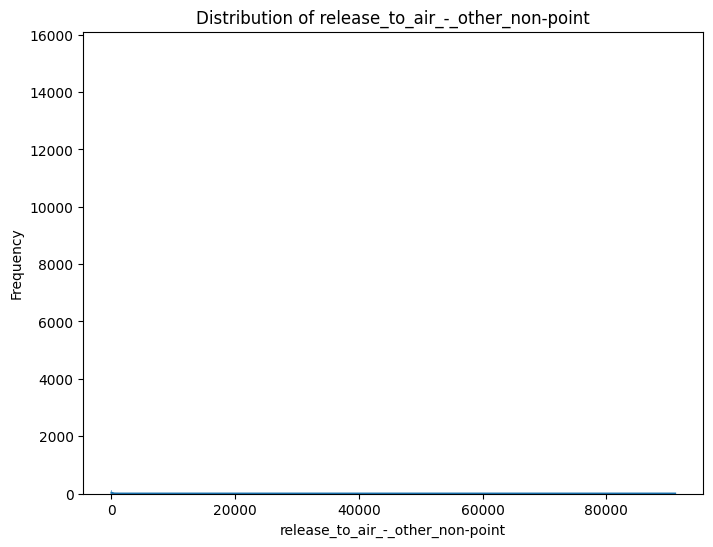

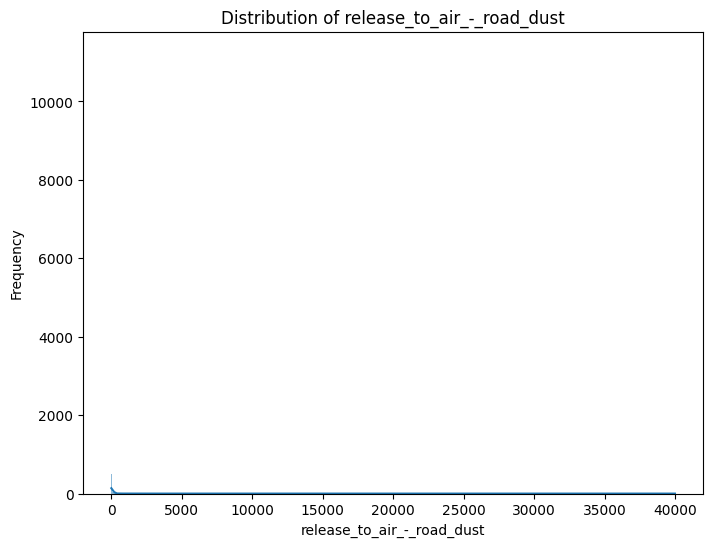

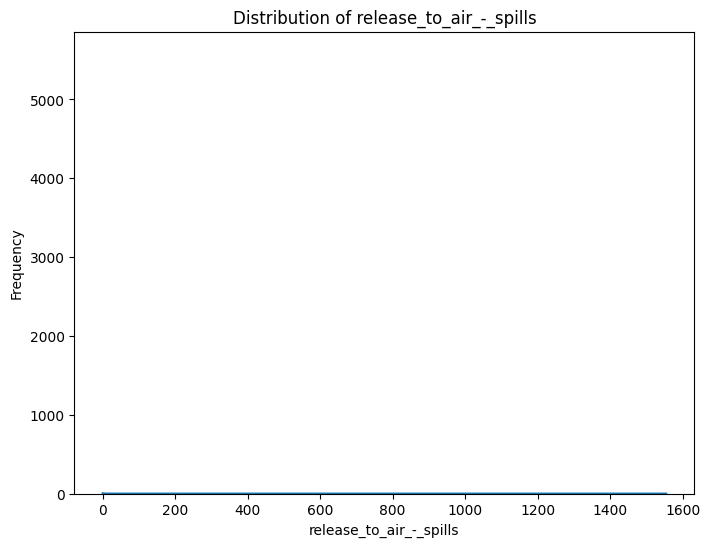

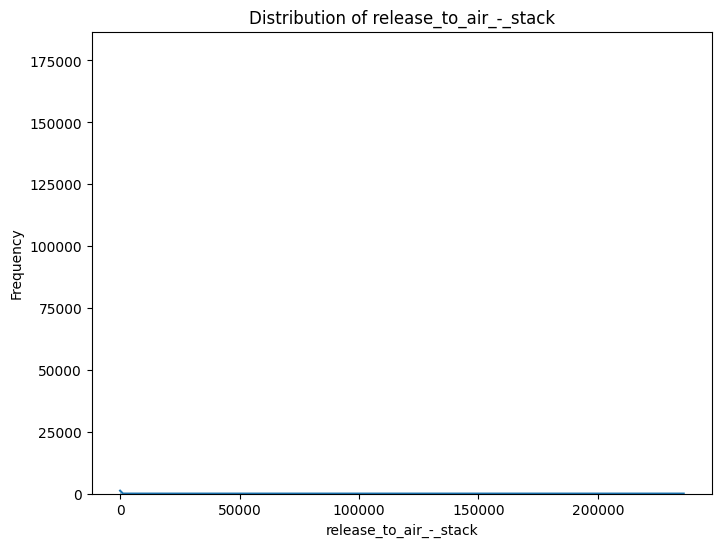

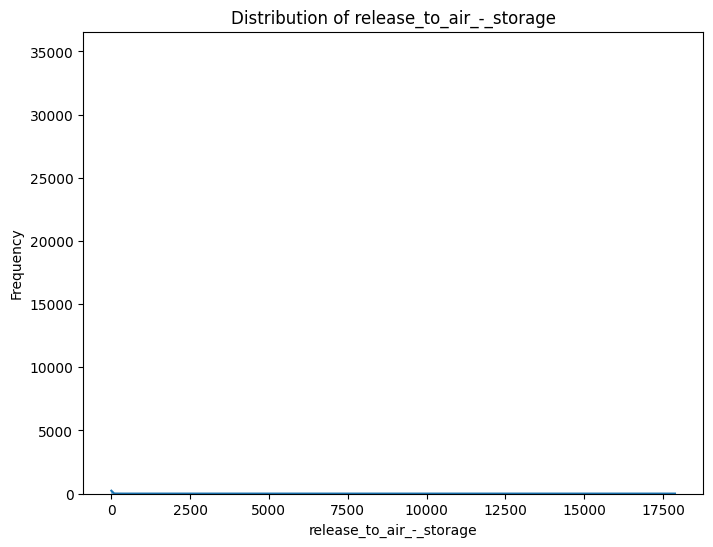

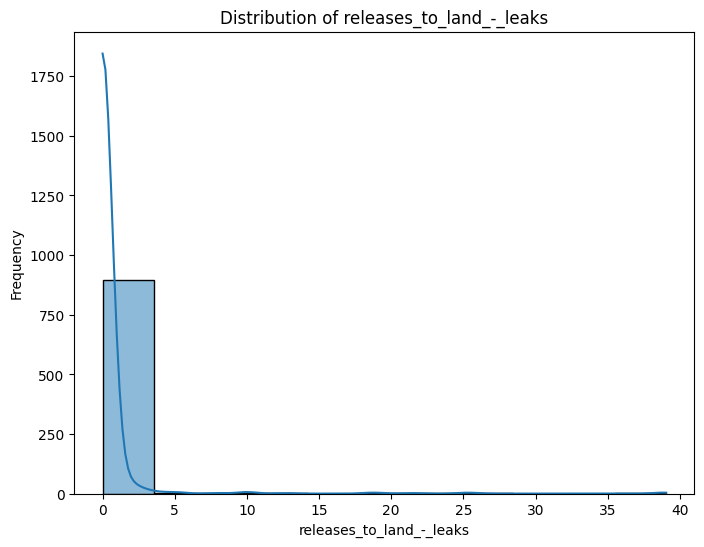

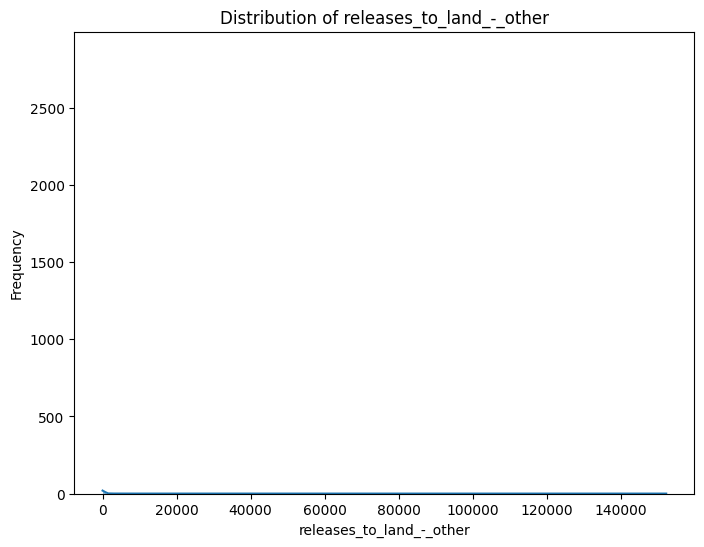

In [ ]:
columns = [
    'release_to_air_-_other_non-point', 'release_to_air_-_road_dust',
    'release_to_air_-_spills', 'release_to_air_-_stack',
    'release_to_air_-_storage', 'releases_to_land_-_leaks',
    'releases_to_land_-_other', 'releases_to_land_-_spills',
    'releases_to_water_bodies_-_direct_discharges',
    'releases_to_water_bodies_-_leaks', 'releases_to_water_bodies_-_spills',
    'sum_of_release_to_all_media_(<1tonne)'
]

for col in columns:
    plt.figure(figsize=(8, 6))
    sns.histplot(df_analysis[col], kde=True)
    plt.title(f'Distribution of {col}')
    plt.xlabel(col)
    plt.ylabel('Frequency')
    plt.show()


Time-Based Trends to examine trends in releases over time

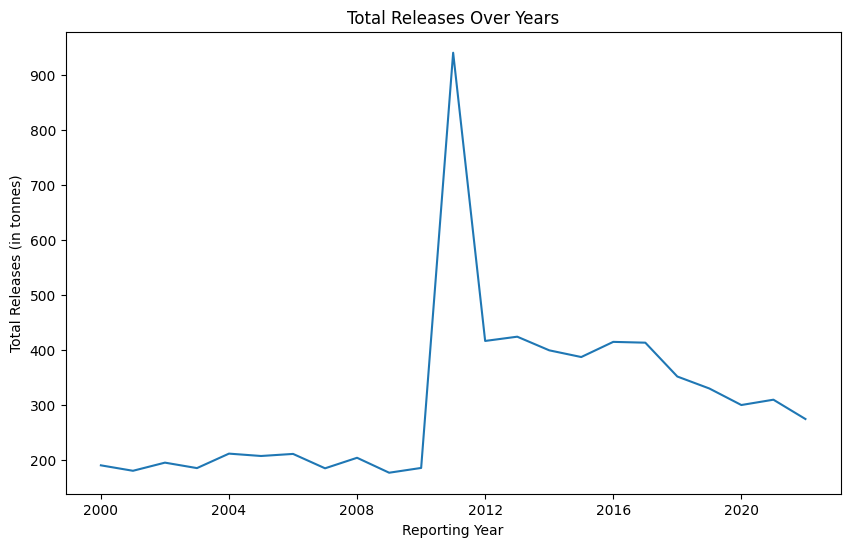

In [37]:
# Summing releases by year
yearly_releases = df_analysis.groupby('reporting_year')['sum_of_release_to_all_media_(<1tonne)'].sum().reset_index()

plt.figure(figsize=(10, 6))
sns.lineplot(data=yearly_releases, x='reporting_year', y='sum_of_release_to_all_media_(<1tonne)')
plt.title('Total Releases Over Years')
plt.xlabel('Reporting Year')
plt.ylabel('Total Releases (in tonnes)')
plt.show()


Geographic Visualization using latitude and longitude to map facilities and color by province

In [36]:
import plotly.express as px

df_analysis['sum_of_release_to_all_media_(<1tonne)'] = df_analysis['sum_of_release_to_all_media_(<1tonne)'].fillna(0)

fig = px.scatter_geo(df_analysis,
                     lat='latitude',
                     lon='longitude',
                     color='province',
                     hover_name='facility_name',
                     size='sum_of_release_to_all_media_(<1tonne)',
                     title='Facility Locations and Release Quantities by Province')
fig.update_geos(projection_type="natural earth")
fig.show()


Comparing Releases by Province or NAICS (Industry Code) to see which provinces or industries have higher release levels

<ipython-input-35-3ede798c6b7f>:2: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

<ipython-input-35-3ede798c6b7f>:5: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




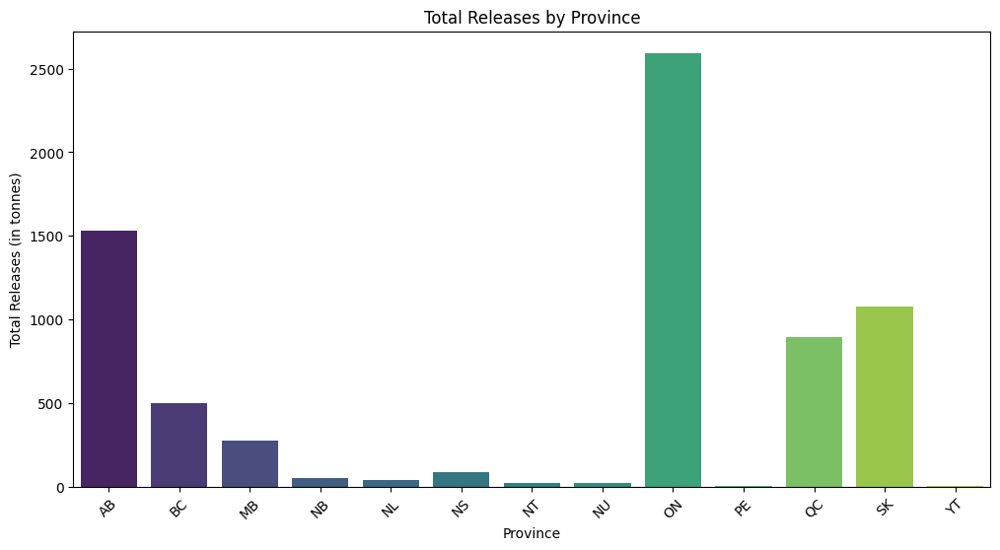

In [35]:
# Summing releases by province
province_releases = df_analysis.groupby('province')['sum_of_release_to_all_media_(<1tonne)'].sum().reset_index()

plt.figure(figsize=(12, 6))
sns.barplot(data=province_releases, x='province', y='sum_of_release_to_all_media_(<1tonne)', palette="viridis")
plt.title('Total Releases by Province')
plt.xlabel('Province')
plt.ylabel('Total Releases (in tonnes)')
plt.xticks(rotation=45)
plt.show()


Viewing release levels by NAICS code

<ipython-input-34-0a4fcc2cf2a0>:2: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

<ipython-input-34-0a4fcc2cf2a0>:5: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




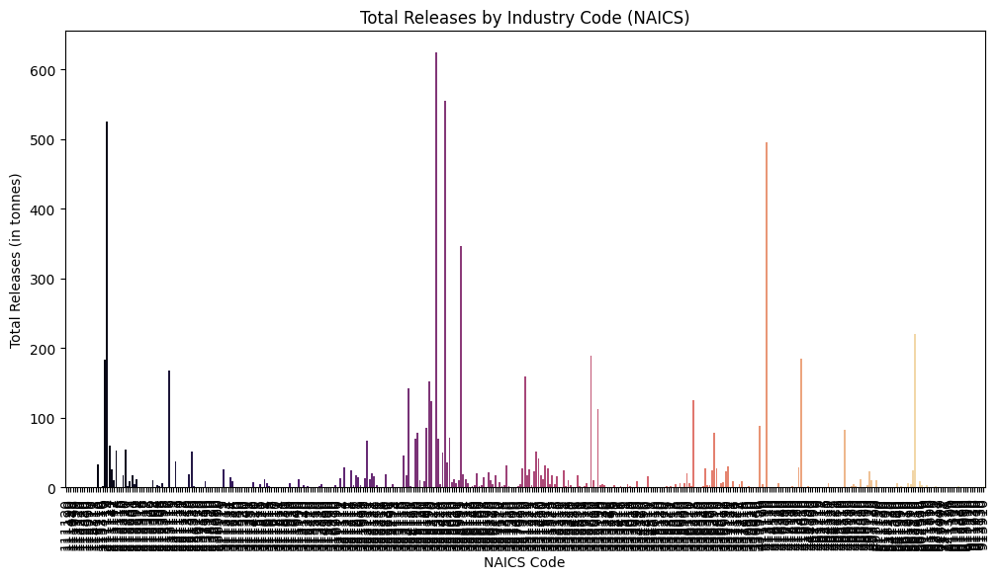

In [34]:
# Summing releases by NAICS
naics_releases = df_analysis.groupby('naics')['sum_of_release_to_all_media_(<1tonne)'].sum().reset_index()

plt.figure(figsize=(12, 6))
sns.barplot(data=naics_releases, x='naics', y='sum_of_release_to_all_media_(<1tonne)', palette="magma")
plt.title('Total Releases by Industry Code (NAICS)')
plt.xlabel('NAICS Code')
plt.ylabel('Total Releases (in tonnes)')
plt.xticks(rotation=90)
plt.show()


Distribution of Various Release Types to compare different types of releases, we can plot each release type’s distribution

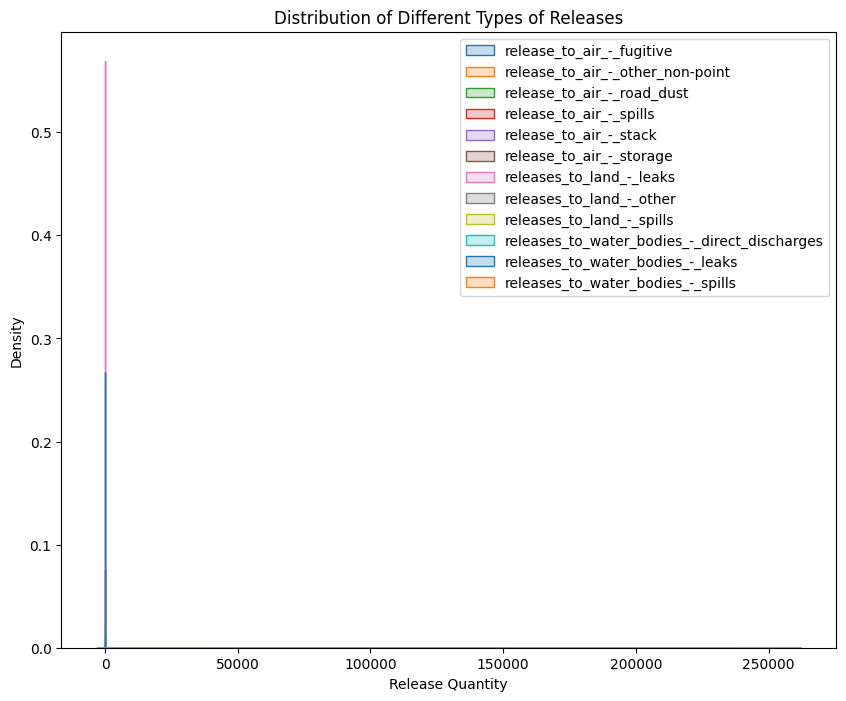

In [33]:
release_columns = [
    'release_to_air_-_fugitive', 'release_to_air_-_other_non-point',
    'release_to_air_-_road_dust', 'release_to_air_-_spills',
    'release_to_air_-_stack', 'release_to_air_-_storage',
    'releases_to_land_-_leaks', 'releases_to_land_-_other',
    'releases_to_land_-_spills', 'releases_to_water_bodies_-_direct_discharges',
    'releases_to_water_bodies_-_leaks', 'releases_to_water_bodies_-_spills'
]

plt.figure(figsize=(10, 8))
for col in release_columns:
    sns.kdeplot(df_analysis[col], label=col, fill=True)

plt.title('Distribution of Different Types of Releases')
plt.xlabel('Release Quantity')
plt.ylabel('Density')
plt.legend()
plt.show()
